![Explore-Our-World-of-Indices](https://github.com/user-attachments/assets/b6efd498-b141-4a81-b9ce-cbf785beb337)

## Importing Libraries

In [1]:
import os
import requests
import pandas as pd
from glob import glob
import plotly.graph_objects as go

## Processing RAW files downloaded from [NIFTY Historical Data](https://www.niftyindices.com/reports/historical-data)

**NOTE**

* All are Total Returns Index Values.
* Start date : **January 01, 2020**.
* End date :  **July 26, 2024**.
* All downloaded TRI **csv** files are stored in `RAW-Data` directory.

In [2]:
PROCESSED_FILES = 'NSE-Processed-Indices'
os.makedirs(PROCESSED_FILES, exist_ok = True)

### Cleaning Data

In [3]:
if len(os.listdir('RAW-Data')) != 0:
    raw_files = glob('RAW-Data/*.csv')
    for file in raw_files:
        df = pd.read_csv(file)
        df.columns = df.columns.str.replace(' ', '_')
        filename = df[df.columns[0]].unique()[0].replace('-', '_').replace(' ', '_')
        df.columns = list(df.columns[:2]) + [filename]
        filename = f'{PROCESSED_FILES}/{filename}.csv'
        df.Date = pd.to_datetime(df.Date, format = '%d %b %Y')
        df.drop(df.columns[0], axis = 1, inplace = True)
        df.to_csv(filename, index = False)
        os.remove(file)

### Processing Data

In [4]:
NIFTY50 = 'NSE-Processed-Indices/NIFTY_50.csv'
files = glob('NSE-Processed-Indices/*.csv')
files.remove(NIFTY50)

In [5]:
dates_, DF = {}, None

DF = pd.read_csv(NIFTY50)
date_ = list(DF.sort_values('Date', ascending = True)['Date'])[0]
name = NIFTY50.split('/')[-1].replace(".csv", "")
dates_[name] = date_

for file in sorted(files):
    df = pd.read_csv(file)
    df.sort_values('Date', ascending = True, inplace = True)
    df.reset_index(drop = True, inplace = True)
    if not isinstance(DF, pd.DataFrame):
        DF = df
    else:
        DF = pd.merge(DF, df, how = 'left', on = 'Date')
    date_ = df.Date[0]
    name = file.split('/')[-1].replace('.csv', '')
    dates_[name] = date_
DF.Date = pd.to_datetime(DF.Date)
DF.sort_values('Date', ascending = True, inplace = True)
DF.reset_index(drop = True, inplace = True)

### Helper Functions

In [6]:
# Function to collect historical NAV of Mutual Funds : Using Web-Scrapping

def get_NAV(FUND, fname, DF_, datePrint_ = True):
    
    URL = f'https://www.advisorkhoj.com/mutual-funds-research/getCompleteNavReportForFundOverview?scheme_amfi_name={FUND}&scheme_inception_date=01-01-2013'
    r = requests.get(URL)
    fundJOSN = r.json()
    df = pd.DataFrame({'Date' : [time for time, nav in fundJOSN], fname : [nav for time, nav in fundJOSN]})
    df.Date = pd.to_datetime(pd.to_datetime(df.Date, unit = 'ms', utc = True).dt.tz_convert('Asia/Kolkata').dt.strftime('%m/%d/%Y'))
    if datePrint_:
        date_ = df.sort_values('Date', ascending = True)['Date'][0].strftime('%d/%m/%Y')
        print(f'{fname:15}: {date_}')
        
    return pd.merge(DF_, df, how = 'left', on = 'Date')

In [7]:
def set_initial(column, initial = 100, df = None):
    list_ = []
    for val in df[column]:
        if pd.isna(val): value = initial
        else: value = round(value * (1+val), 3)
        list_.append(value)
    return list_

In [8]:
def getDF(dF, sDate, eDate, coL_, initial_ = 100, print_ = False):
    
    dFF_ =  dF.query('@sDate <= Date <= @eDate')[coL_].dropna().copy(deep = True)
    if print_:
        for XX in coL_:
            print(f'{XX:50}{dates_.get(XX)}')

    for col in dFF_.columns[1:]:
        new_col = col
        # new_col = col + '_'
        dFF_[new_col] = dFF_[col].pct_change(1)

    for col in dFF_.columns[1:]:
        new_col = col
        # new_col = col + '_'
        dFF_[new_col] = set_initial(col, initial = initial_, df = dFF_)
    
    return dFF_

In [9]:
def plot_(dF, co_, pctPlot = False, template_ = 'plotly'):

    fig = go.Figure()
    for col in dF.columns[1:]:
        if col not in co_:
            init_ = dF[col].values[0]
            lis_ = pd.Series([round(((val/init_)-1), 3) for val in df_[col].values])
            if pctPlot:
                fig.add_trace(go.Scatter(x = dF.Date, y = lis_, mode = 'lines', name = col, customdata = round(dF[col], 3), hovertemplate = "%{customdata} :: %{y}"))
            else: fig.add_trace(go.Scatter(x = dF.Date, y = dF[col], mode = 'lines', name = col, customdata = round(lis_ * 100, 3), hovertemplate = "%{y} :: %{customdata}%"))

    if pctPlot: fig.update_yaxes(tickformat = '.2%')
    fig.update_layout(hovermode = 'x')
    fig.update_layout(template = template_)
    fig.update_layout(autosize = True, height = 600)
    fig.show()

In [10]:
def add_labels(dff_, capSplit):
    try:
        capSplit = {mCap : capSplit[mCap]/100 for mCap in capSplit}
        
        NI50 = 0.7 ; NEXT = 1 - NI50
        NI50 = capSplit.get('LargeCap') * NI50
        NEXT = capSplit.get('LargeCap') * NEXT

        folioName = 'Normal-Index-Folio-' + ':'.join([str(int(capSplit[mCap]*100)) for mCap in capSplit])
        dff_[folioName] = df_.NIFTY_50 * NI50 + df_.NIFTY_NEXT_50 * NEXT + df_.NIFTY_MIDCAP_150 * capSplit.get('MidCap') + df_.NIFTY_SMALLCAP_250 * capSplit.get('SmallCap') 
        
        folioName = 'Momentum-Index-Folio-' + ':'.join([str(int(capSplit[mCap]*100)) for mCap in capSplit])
        dff_[folioName] = df_.NIFTY_50 * NI50 + df_.NIFTY_NEXT_50 * NEXT + df_.NIFTY_MIDCAP150_MOMENTUM_50 * capSplit.get('MidCap') + df_.NIFTY_SMALLCAP250_MOMENTUM_QUALITY_100 * capSplit.get('SmallCap') 
    
    except: pass
    return dff_

### Collecting Mutual Fund NAVs

In [11]:
MFS = {
        'Parag-Parikh-Flexi-Cap-Fund-Direct-Plan-Growth' : 'PPFAS_FCF',
        # 'advisorkhoj_url' : 'fund_name',
    }

for url_key, Fname in MFS.items():
    if not Fname in DF.columns:
        DF = get_NAV(url_key, Fname, DF)

PPFAS_FCF      : 21/05/2013


### Choosing the indiecs / MFs for the further analysis

In [12]:
indices = [co for co in DF.columns if 'nifty'.lower() in co.lower()]
# indices.remove('NIFTY_MICROCAP_250')

MFs = [co for co in DF.columns if not 'nifty'.lower() in co.lower()]
MFs.remove('Date')

includeColumns = ['Date'] + indices

In [13]:
excludeColumns = [
                # 'NIFTY_50',
                # 'NIFTY200_MOMENTUM_30',
                'NIFTY_200',
                'NIFTY_LARGEMIDCAP_250',
                # 'NIFTY_MICROCAP_250',
                # 'NIFTY_MIDCAP150_MOMENTUM_50',
                # 'NIFTY_MIDCAP_150',
                'NIFTY_MIDSMALLCAP400_MOMENTUM_QUALITY_100',
                # 'NIFTY_NEXT_50',
                # 'NIFTY_NON_CYCLICAL_CONSUMER',
                # 'NIFTY_SMALLCAP250_MOMENTUM_QUALITY_100',
                # 'NIFTY_SMALLCAP_250',
                'NIFTY_TOTAL_MARKET',
                # 'PPFAS_FCF'
                  ]

mCapSplit = {'LargeCap' : 40, 'MidCap' : 35, 'SmallCap' : 25}

## Plotting Charts of various dates of a fixed time frame

### Period of Infra Rally in India before GFC

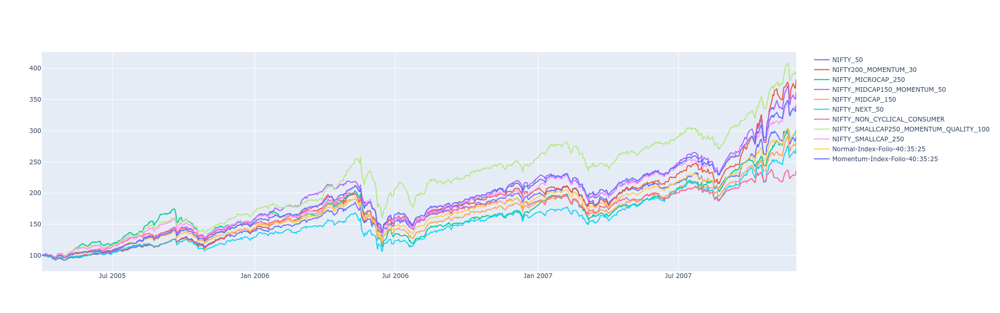

In [14]:
date_S = '2005-04-01'
date_E = '2007-12-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### GFC Crash

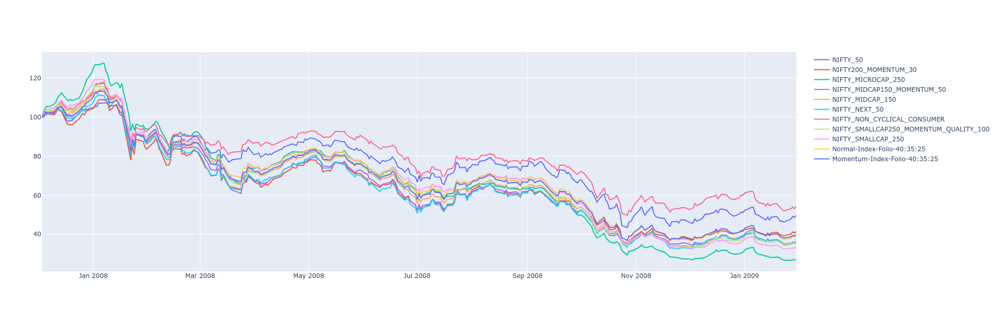

In [15]:
date_S = '2007-12-01'
date_E = '2009-02-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### Post GFC Recovery Phase

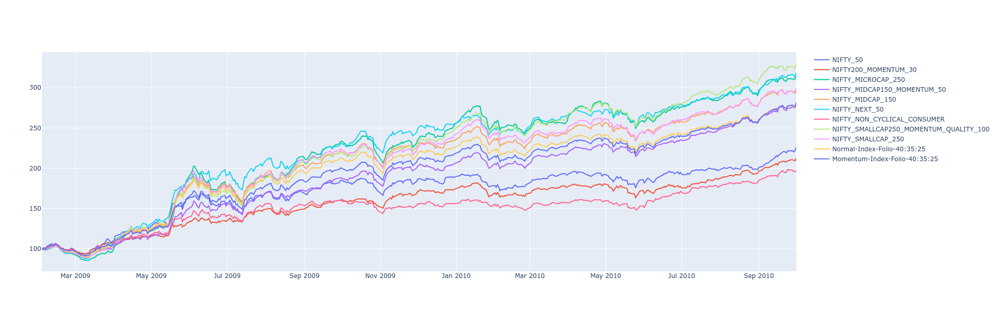

In [16]:
date_S = '2009-02-01'
date_E = '2010-10-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### PIIGS Crisis / Taper Tantrum

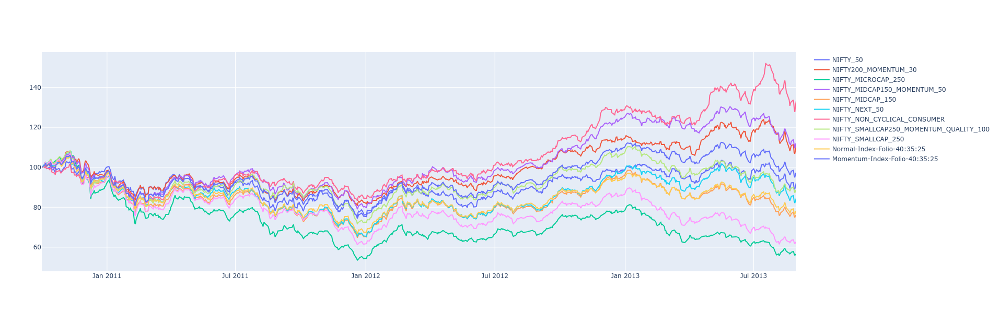

In [17]:
date_S = '2010-10-01'
date_E = '2013-09-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### Modi Government coming to Power

In [18]:
# Parag Parikh Flexi Cap Fund Direct Plan introduced in 2013
includeColumns = ['Date'] + indices + MFs

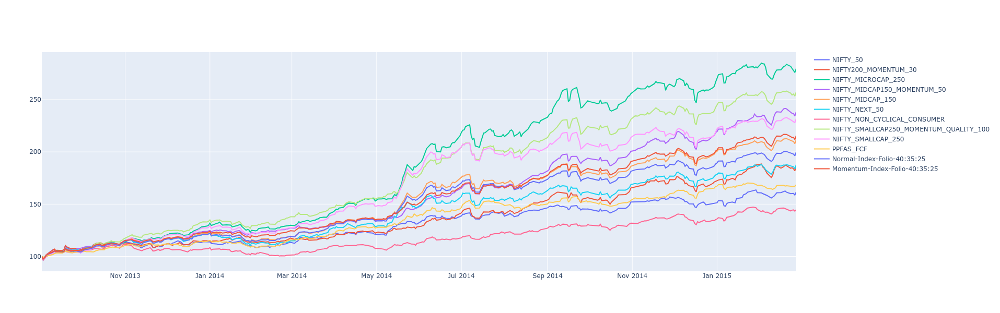

In [19]:
date_S = '2013-09-01'
date_E = '2015-03-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### RBI AQR, Demonetization, NBFC Crisis, GST, RERA

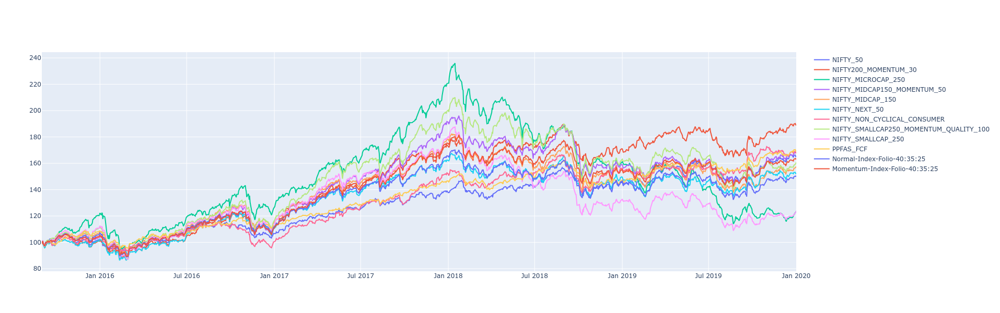

In [20]:
date_S = '2015-09-01'
date_E = '2020-01-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### Covid Crash

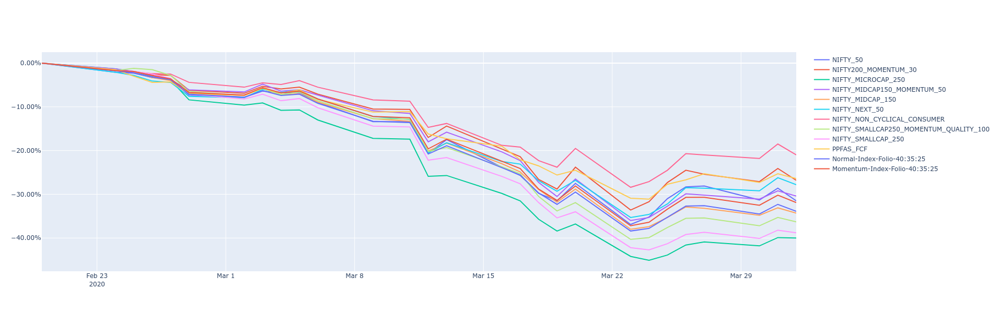

In [21]:
date_S = '2020-02-20'
date_E = '2020-04-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = True)

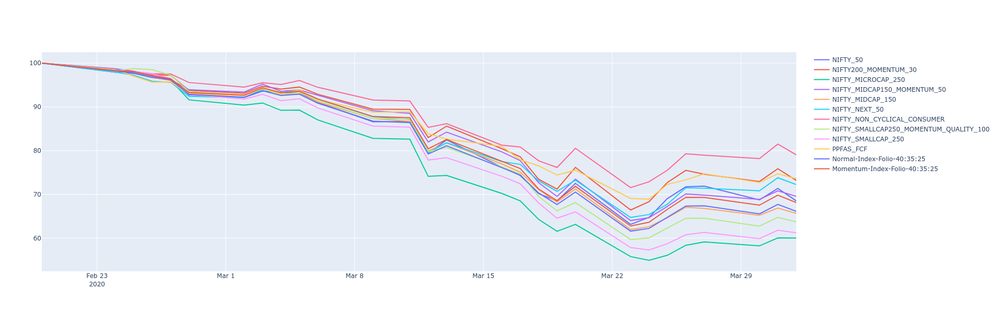

In [22]:
date_S = '2020-02-20'
date_E = '2020-04-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### Post Covid Recovery

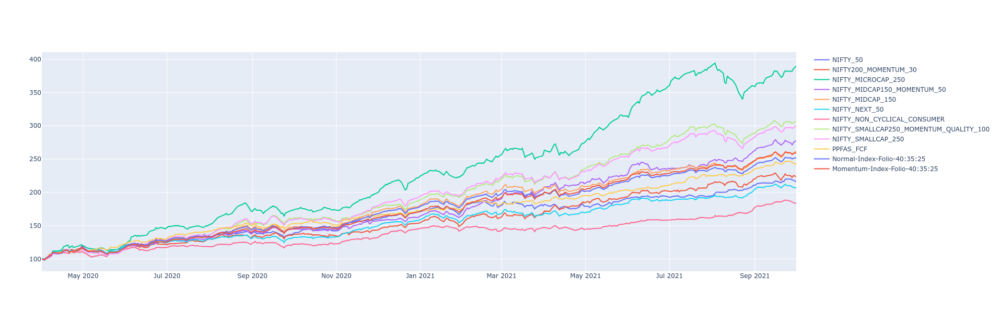

In [23]:
date_S = '2020-04-01'
date_E = '2021-10-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### Rising Inflation and Rate Tightening

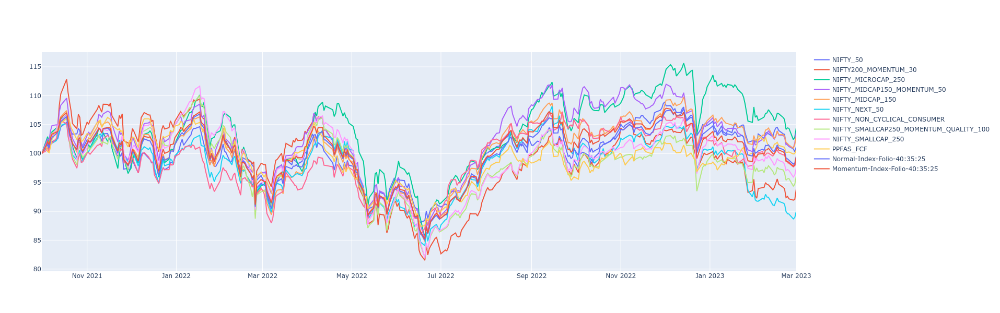

In [24]:
date_S = '2021-10-01'
date_E = '2023-03-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### Moderating Inflation / Expectation of Rate Cut Cycle

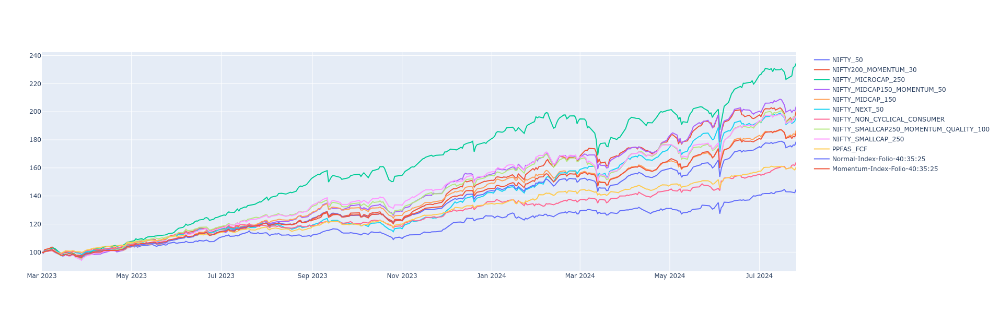

In [25]:
date_S = '2023-03-01'
date_E = '2024-08-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

## Indices rally from major events till NOW 

### From GFC Crash begining till NOW 

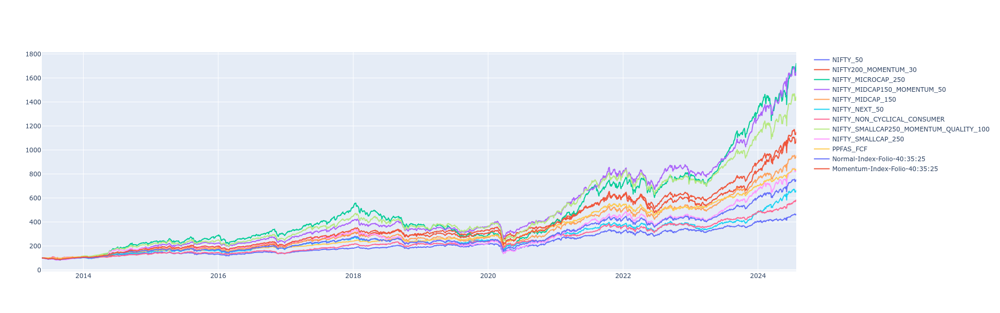

In [26]:
date_S = '2007-12-01'
date_E = '2024-08-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### From Demonetization, NBFC Crisis till NOW

In [27]:
includeColumns = ['Date'] + indices + MFs

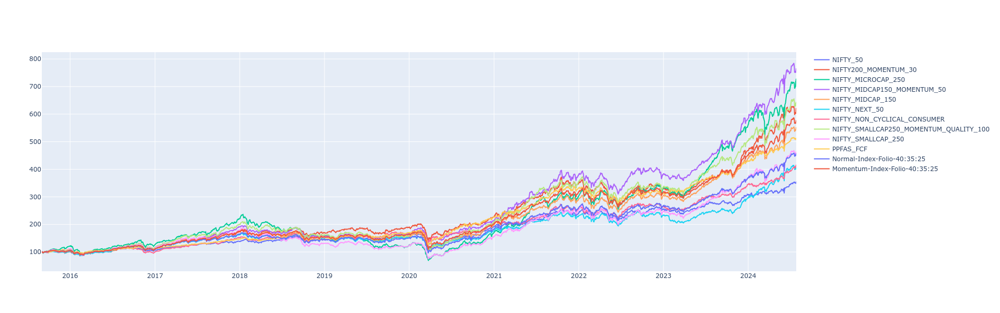

In [28]:
date_S = '2015-09-01'
date_E = '2024-08-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

### Post Covid Recovery till NOW

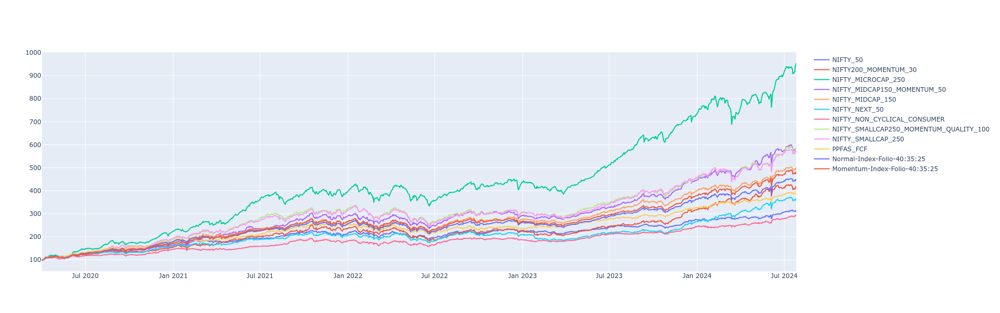

In [29]:
date_S = '2020-04-01'
date_E = '2024-08-01'

df_ = getDF(DF, date_S, date_E, includeColumns, initial_ = 100, print_ = False)
df_ = add_labels(df_, mCapSplit)
plot_(df_, excludeColumns, pctPlot = False)

## References

* [advisorkhoj](https://www.advisorkhoj.com/) : Used for Mutual Fund historical NAV data.
* [NIFTY Historical Data](https://www.niftyindices.com/reports/historical-data) : Used for getting TRI data.
* [Understanding Stock Market Trends Over 20 Years | Parimal Ade](https://youtu.be/n7Pxdo--HR4?si=7Vv5sMrqzUpAcFuU) : Referred for Historical Major events.